<a href="https://colab.research.google.com/github/deep-ll/sound_event_detection_localiztion_under_university-of-surrey/blob/main/SPEC_AUG30_.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
#authentication
from google.colab import auth
auth.authenticate_user()

#accessing cloud data
!echo "deb http://packages.cloud.google.com/apt gcsfuse-bionic main" > /etc/apt/sources.list.d/gcsfuse.list
!curl https://packages.cloud.google.com/apt/doc/apt-key.gpg | apt-key add -
!apt -qq update
!apt -qq install gcsfuse

!mkdir colab_direcoty
!gcsfuse --implicit-dirs aug-1 colab_direcoty

In [ ]:
!wget https://developer.nvidia.com/compute/cuda/9.0/Prod/local_installers/cuda-repo-ubuntu1604-9-0-local_9.0.176-1_amd64-deb
!dpkg -i cuda-repo-ubuntu1604-9-0-local_9.0.176-1_amd64-deb
!apt-key add /var/cuda-repo-9-0-local/7fa2af80.pub
!apt-get update
!apt-get install cuda=9.0.176-1

In [ ]:
#required libraries
#!pip3 install sox
!pip install audiomentations==0.20.0
!pip install tensorflow==1.14.0
!pip install tensorflow-gpu==1.14.0
!pip install q keras==2.3.1
!pip install h5py==2.10.0
#!pip install torch-audiomentations
#!pip install nlpaug
#!pip install audiomentations
!pip install librosa --upgrade
#!pip install librosa==0.8.1
#!pip install pydub==0.25.1
#!pip install -r/content/colab_direcoty/requirements.txt

In [ ]:
!python batch_feature_extraction.py


In [ ]:
%cd /content/colab_direcoty/seld-dcase2020-master

/content/colab_direcoty/seld-dcase2020-master


In [ ]:
#!pip install nlpaug
#!pip install librosa
from audiomentations import Compose, AddGaussianNoise, TimeStretch, PitchShift, Shift
import librosa.display

In [ ]:
import scipy.io.wavfile as wav
#import nlpaug.augmenter#masking
#from nlpaug.augmenter import spectrogram as nas#masking
#from audiomentations import SpecCompose, SpecChannelShuffle, SpecFrequencyMask#masking
import numpy as np
import librosa
#import nlpaug.augmenter#masking
#from nlpaug.augmenter import spectrogram as nas#masking
import matplotlib.pyplot as plot
import matplotlib.gridspec as gridspec
#aug = nas.TimeMaskingAug(zone=(0.2, 0.3), coverage=1)#time masking
#augment = SpecCompose([SpecFrequencyMask([(( ([max_mask_fraction: float = 0.25]), p=0.3)])
#mask_fraction = 0.05
#transform = SpecFrequencyMask(fill_mode="constant",fill_constant=0.0,min_mask_fraction=0.05,max_mask_fraction=0.07,p=0.4)
#augmented_spectrogram = transform(magnitude_spectrogram)



In [ ]:
def _spectrogram(audio_input):
        #transform = SpecFrequencyMask(fill_mode="constant",fill_constant=0.0,min_mask_fraction=0.07,max_mask_fraction=0.09,p=0.4)
        _max_feat_frames=3000
        _win_len=960
        _nfft=1024
        _hop_len=480
        _nb_ch = audio_input.shape[1]
        nb_bins = _nfft // 2
        spectra = np.zeros((_max_feat_frames, nb_bins + 1, _nb_ch), dtype=complex)
        for ch_cnt in range(_nb_ch):
            stft_ch = librosa.core.stft(np.asfortranarray(audio_input[:, ch_cnt]), n_fft=_nfft, hop_length=_hop_len,
                                        win_length=_win_len, window='hann')
            #stft_ch=transform(stft_ch)#frequency masking
            print("hi")
            spectra[:, :, ch_cnt] = stft_ch[:, :_max_feat_frames].T
        return spectra


In [ ]:
def _load_audio(audio_path):
        fs, audio = wav.read(audio_path)
        #print(audio)
        _nb_channels = 4
        _eps = 1e-8
        _audio_max_len_samples=1440000 #60*24000
        audio = audio[:,:_nb_channels] / 32768.0 + _eps
        if audio.shape[0] < _audio_max_len_samples:
            zero_pad = np.random.rand(_audio_max_len_samples - audio.shape[0], audio.shape[1])*_eps
            audio = np.vstack((audio, zero_pad))
        elif audio.shape[0] > _audio_max_len_samples:
            audio = audio[:_audio_max_len_samples, :]
        print("hi")
        augment = Compose([AddGaussianNoise(min_amplitude=0.001, max_amplitude=0.015, p=0.4),])
        audio = augment(samples=audio, sample_rate=24000)
        return audio, fs


In [ ]:
a1,f1=_load_audio("/content/sample_data/fold1_room1_mix001_ov1.wav")
print(a1.shape)

hi
(1440000, 4)


hi


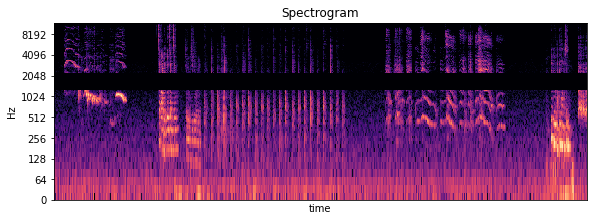

In [ ]:
stft = np.abs(np.squeeze(_spectrogram(a1[:, :1])))
stft = librosa.amplitude_to_db(stft, ref=np.max)

plot.figure(figsize=(20, 15))
gs = gridspec.GridSpec(4, 4)


ax0 = plot.subplot(gs[0, 1:3]), librosa.display.specshow(stft.T,sr=f1, x_axis='s', y_axis='log'), plot.xlim([0, 60]), plot.xticks([]), plot.xlabel('time'), plot.title('Spectrogram')

hi


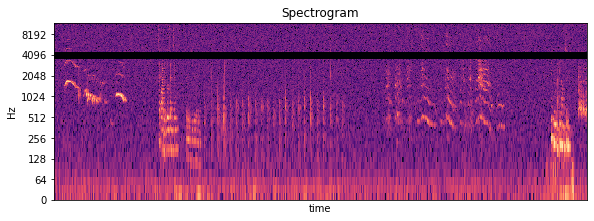

In [ ]:
#spec augment with guassian noise

stft = np.abs(np.squeeze(_spectrogram(a1[:, :1])))
stft = librosa.amplitude_to_db(stft, ref=np.max)

plot.figure(figsize=(20, 15))
gs = gridspec.GridSpec(4, 4)


ax0 = plot.subplot(gs[0, 1:3]), librosa.display.specshow(stft.T,sr=f1, x_axis='s', y_axis='log'), plot.xlim([0, 60]), plot.xticks([]), plot.xlabel('time'), plot.title('Spectrogram')

In [ ]:
!python batch_feature_extraction.py #dev

In [ ]:
!python batch_feature_extraction.py #eval

In [ ]:
!python seld.py 4 #frequency masking

Using TensorFlow backend.
/usr/local/lib/python3.7/dist-packages/tensorflow/python/framework/dtypes.py:516: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint8 = np.dtype([("qint8", np.int8, 1)])
/usr/local/lib/python3.7/dist-packages/tensorflow/python/framework/dtypes.py:517: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_quint8 = np.dtype([("quint8", np.uint8, 1)])
/usr/local/lib/python3.7/dist-packages/tensorflow/python/framework/dtypes.py:518: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint16 = np.dtype([("qint16", np.int16, 1)])
/usr/local/lib/python3.7/dist-packages/tensorflow/python/framework/dtypes.py:519: FutureWarn

In [ ]:
!python calculate_dev_results_from_dcase_output.py #freq aug

SET: 1
USING DEFAULT PARAMETERS

	quick_test: False
	dataset_dir: /content/colab_direcoty
	feat_label_dir: /content/colab_direcoty/feat_label/
	model_dir: models/
	dcase_output: True
	dcase_dir: results/
	mode: dev
	dataset: foa
	fs: 24000
	hop_len_s: 0.02
	label_hop_len_s: 0.1
	max_audio_len_s: 60
	nb_mel_bins: 64
	label_sequence_length: 60
	batch_size: 128
	dropout_rate: 0
	nb_cnn2d_filt: 64
	f_pool_size: [4, 4, 2]
	rnn_size: [128, 128]
	fnn_size: [128]
	loss_weights: [1.0, 1000.0]
	nb_epochs: 50
	epochs_per_fit: 5
	doa_objective: masked_mse
	lad_doa_thresh: 20
	feature_sequence_length: 300
	t_pool_size: [5, 1, 1]
	patience: 50
	unique_classes: {'alarm': 0, 'baby': 1, 'crash': 2, 'dog': 3, 'engine': 4, 'female_scream': 5, 'female_speech': 6, 'fire': 7, 'footsteps': 8, 'knock': 9, 'male_scream': 10, 'male_speech': 11, 'phone': 12, 'piano': 13}
Number of predicted files: 100
Number of reference files: 601

Calculating ['all', 'ov', 'ir'] scores for 4_foa_dev


-------------------------

In [ ]:
!python seld.py

Using TensorFlow backend.
/usr/local/lib/python3.7/dist-packages/tensorflow/python/framework/dtypes.py:516: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint8 = np.dtype([("qint8", np.int8, 1)])
/usr/local/lib/python3.7/dist-packages/tensorflow/python/framework/dtypes.py:517: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_quint8 = np.dtype([("quint8", np.uint8, 1)])
/usr/local/lib/python3.7/dist-packages/tensorflow/python/framework/dtypes.py:518: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint16 = np.dtype([("qint16", np.int16, 1)])
/usr/local/lib/python3.7/dist-packages/tensorflow/python/framework/dtypes.py:519: FutureWarn

In [ ]:
!python calculate_dev_results_from_dcase_output.py

SET: 1
USING DEFAULT PARAMETERS

	quick_test: False
	dataset_dir: /content/colab_direcoty
	feat_label_dir: /content/colab_direcoty/feat_label/
	model_dir: models/
	dcase_output: True
	dcase_dir: results/
	mode: eval
	dataset: foa
	fs: 24000
	hop_len_s: 0.02
	label_hop_len_s: 0.1
	max_audio_len_s: 60
	nb_mel_bins: 64
	label_sequence_length: 60
	batch_size: 128
	dropout_rate: 0
	nb_cnn2d_filt: 64
	f_pool_size: [4, 4, 2]
	rnn_size: [128, 128]
	fnn_size: [128]
	loss_weights: [1.0, 1000.0]
	nb_epochs: 50
	epochs_per_fit: 5
	doa_objective: masked_mse
	lad_doa_thresh: 20
	feature_sequence_length: 300
	t_pool_size: [5, 1, 1]
	patience: 50
	unique_classes: {'alarm': 0, 'baby': 1, 'crash': 2, 'dog': 3, 'engine': 4, 'female_scream': 5, 'female_speech': 6, 'fire': 7, 'footsteps': 8, 'knock': 9, 'male_scream': 10, 'male_speech': 11, 'phone': 12, 'piano': 13}
Number of predicted files: 200
Number of reference files: 200

Calculating ['all', 'ov', 'ir'] scores for 1_foa_eval


-----------------------

In [ ]:
!python visualize_SELD_output.py

SET: 1
USING DEFAULT PARAMETERS

	quick_test: False
	dataset_dir: /content/colab_direcoty
	feat_label_dir: /content/colab_direcoty/feat_label/
	model_dir: models/
	dcase_output: True
	dcase_dir: results/
	mode: eval
	dataset: foa
	fs: 24000
	hop_len_s: 0.02
	label_hop_len_s: 0.1
	max_audio_len_s: 60
	nb_mel_bins: 64
	label_sequence_length: 60
	batch_size: 128
	dropout_rate: 0
	nb_cnn2d_filt: 64
	f_pool_size: [4, 4, 2]
	rnn_size: [128, 128]
	fnn_size: [128]
	loss_weights: [1.0, 1000.0]
	nb_epochs: 50
	epochs_per_fit: 5
	doa_objective: masked_mse
	lad_doa_thresh: 20
	feature_sequence_length: 300
	t_pool_size: [5, 1, 1]
	patience: 50
	unique_classes: {'alarm': 0, 'baby': 1, 'crash': 2, 'dog': 3, 'engine': 4, 'female_scream': 5, 'female_speech': 6, 'fire': 7, 'footsteps': 8, 'knock': 9, 'male_scream': 10, 'male_speech': 11, 'phone': 12, 'piano': 13}
hi


In [ ]:
def _load_audio(audio_path):
        fs, audio = wav.read(audio_path)
        _nb_channels = 4
        _eps = 1e-8
        _audio_max_len_samples=1440000 #60*24000
        audio = audio[:,:_nb_channels] / 32768.0 + _eps
        if audio.shape[0] < _audio_max_len_samples:
            zero_pad = np.random.rand(_audio_max_len_samples - audio.shape[0], audio.shape[1])*_eps
            audio = np.vstack((audio, zero_pad))
        elif audio.shape[0] > _audio_max_len_samples:
            audio = audio[:_audio_max_len_samples, :]
        augment = Compose([AddGaussianNoise(min_amplitude=0.001, max_amplitude=0.015, p=0.3),
                          #TimeStretch(min_rate=0.8, max_rate=1.25,p=0.3),
                          #PitchShift(min_semitones=-1, max_semitones=1,p=0.3),
                          #Shift(min_fraction=-0.5, max_fraction=0.5, p=0.3),
                          ])
        #audio=np.reshape(audio, (4, 1440000))
        #audio = augment(audio,24000)
        #audio=np.reshape(audio, (1440000,4))
        return audio, fs


In [ ]:
plt.rcParams["figure.figsize"] = [7.50, 3.50]
plt.rcParams["figure.autolayout"] = True
#input_data = wav.read("/content/colab_direcoty/foa_dev/fold1_room1_mix001_ov1.wav")
#input_data1=wav.read("/content/fold1_room1_mix001_ov1.wav")
#fs, audio = wav.read(audio_path)

#audio = input_data[1]
audio=a2[1]
print(audio)
#audio2=audio2[:5000]
#audio1 = input_data[0]
#print(audio1)
#plt.figure(figsize=[15,14])
pyplot.xscale('log')
plt.plot(np.linspace(0, 1, len(audio[0:24000])), audio[0:24000])
#plt.plot(np.linspace(0, 1, len(audio2[0:24000])), audio2[0:24000])
plt.plot(audio[0:24000])
#plt.grid(c='grey')

#plt.plot(audio2[0:5000])
plt.grid(c='grey')

plt.ylabel("Amplitude")
plt.xlabel("Time")
plt.show()
#fig, axs = plt.subplots(2)
#fig.suptitle('Vertically stacked subplots')
#axs[0].plot(audio[0:24000])
#plt.grid(c='grey')

#axs[1].plot(audio2[0:24000])
#plt.grid(c='grey')
#plt.savefig('f1.png')

[ 1.00000000e-08 -3.05075781e-05  1.00000000e-08  1.00000000e-08]


NameError: ignored

In [ ]:
from audiomentations import LowPassFilter
import librosa.display
import IPython.display
import soundfile
import torchaudio
import plotly.graph_objects as go
import numpy as np
import matplotlib.pyplot as plt
#import matplotlib.pyplot as plot


In [ ]:
a2,f2=_load_audio("/content/colab_direcoty/foa_dev/fold1_room1_mix001_ov1.wav")
print(a2.shape)

(1440000, 4)


In [ ]:
def _spectrogram(audio_input):
        #transform = SpecFrequencyMask(fill_mode="constant",fill_constant=0.0,min_mask_fraction=0.05,max_mask_fraction=0.07,p=0.4)
        #/augment=LowPassFilter(min_cutoff_freq=512,max_cutoff_freq=1000,p=0.5)
        _max_feat_frames=3000
        _win_len=960
        _nfft=1024
        _hop_len=480
        _nb_ch = audio_input.shape[1]
        nb_bins = _nfft // 2
        spectra = np.zeros((_max_feat_frames, nb_bins + 1, _nb_ch), dtype=complex)
        for ch_cnt in range(_nb_ch):
            stft_ch = librosa.core.stft(np.asfortranarray(audio_input[:, ch_cnt]), n_fft=_nfft, hop_length=_hop_len,
                                        win_length=_win_len, window='hann')
            #stft_ch=transform(stft_ch)#frequency masking

            print("hi")
            spectra[:, :, ch_cnt] = stft_ch[:, :_max_feat_frames].T
        return spectra

hi


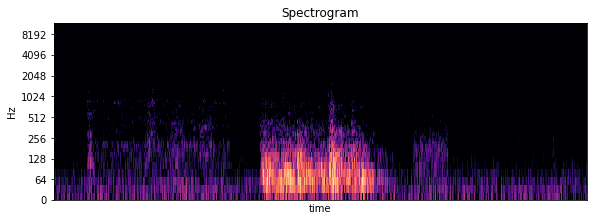

In [ ]:
stft = np.abs(np.squeeze(_spectrogram(a2[:, :1])))
stft = librosa.amplitude_to_db(stft, ref=np.max)

plot.figure(figsize=(20, 15))
gs = gridspec.GridSpec(4, 4)


ax0 = plot.subplot(gs[0, 1:3]), librosa.display.specshow(stft.T,sr=24000, x_axis='s', y_axis='log'), plot.xlim([0, 60]), plot.xticks([]), plot.xlabel('time'), plot.title('Spectrogram')

In [ ]:
def plot_waveform(waveform, sample_rate, title="Waveform", xlim=None):
    waveform = waveform.numpy()

    num_channels, num_frames = waveform.shape
    time_axis = torch.arange(0, num_frames) / sample_rate

    figure, axes = plt.subplots(num_channels, 1)
    if num_channels == 1:
        axes = [axes]
    for c in range(num_channels):
        axes[c].plot(time_axis, waveform[c], linewidth=1)
        axes[c].grid(True)
        if num_channels > 1:
            axes[c].set_ylabel(f"Channel {c+1}")
        if xlim:
            axes[c].set_xlim(xlim)
    figure.suptitle(title)
    plt.show(block=False)

In [ ]:
def plot_specgram(waveform, sample_rate, title="Spectrogram", xlim=None):
    waveform = waveform.numpy()

    num_channels, _ = waveform.shape

    figure, axes = plt.subplots(num_channels, 1)
    if num_channels == 1:
        axes = [axes]
    for c in range(num_channels):
        axes[c].specgram(waveform[c], Fs=sample_rate)
        if num_channels > 1:
            axes[c].set_ylabel(f"Channel {c+1}")
        if xlim:
            axes[c].set_xlim(xlim)
    figure.suptitle(title)
    plt.show(block=False)

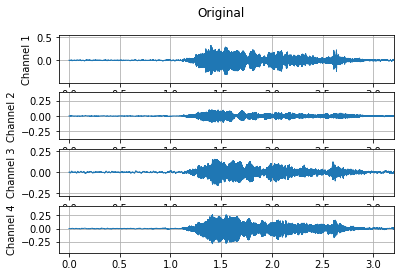

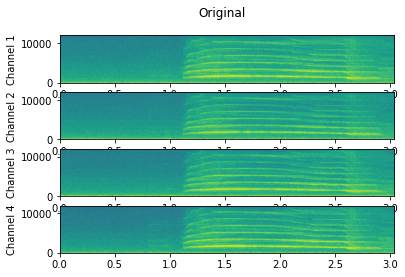

In [ ]:
plot_waveform(waveform1, sample_rate1, title="Original", xlim=(-0.1, 3.2))
plot_specgram(waveform1, sample_rate1, title="Original", xlim=(0, 3.04))
Audio(waveform1, rate=sample_rate1)

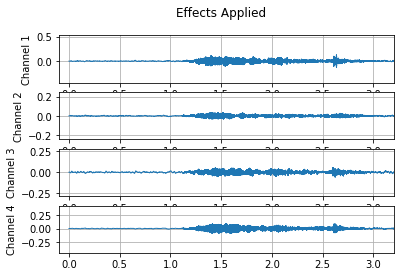

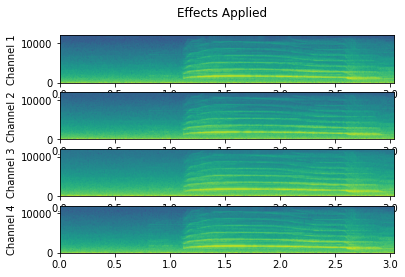

In [ ]:
plot_waveform(waveform2, sample_rate2, title="Effects Applied", xlim=(-0.1, 3.2))
plot_specgram(waveform2, sample_rate2, title="Effects Applied", xlim=(0, 3.04))
Audio(waveform2, rate=sample_rate2)

In [ ]:
pathAudio="/content/colab_direcoty/foa_dev"
files = librosa.util.find_files(pathAudio, ext=['wav'])
files = np.asarray(files)
i=0
for y1 in files:
    i=i+1
    print(i)
    k1=os.path.basename(y1)
    m1,n1= os.path.splitext(k1)
    print(m1)
    wave, sample = torchaudio.load(y1)

    if i%5==0:
    # Define effects
      effects = [
                 ["lowpass", "-2", "1000"],  # apply single-pole lowpass filter
                 #["speed", "0.8"],  # reduce the speed
                 #["rate", f"{sample_rate1}"],
                 #["reverb", "-w"],  # Reverbration gives some dramatic feeling
      ]
      wave1, sample1 = torchaudio.sox_effects.apply_effects_tensor(wave, sample, effects)
      print(wave1.shape)
      print("hi")
      path="/content/sample_data/foa_dev/"+f"{m1}.wav"
      torchaudio.save(path, wave1, sample_rate=24000)
    else:
      print(wave.shape)
      print("bye")
      path="/content/sample_data/foa_dev/"+f"{m1}.wav"
      torchaudio.save(path, wave, sample_rate=24000)

In [ ]:
!zip -r /content/sample_data/foa_dev.zip /content/sample_data/foa_dev

In [ ]:
!cp -r "/content/sample_data/foa_dev.zip" "/content/colab_direcoty/seld-dcase2020-master/c"


In [ ]:
!python batch_feature_extraction.py  #low pass filter 1000hz

SET: 1
USING DEFAULT PARAMETERS

	quick_test: False
	dataset_dir: /content/colab_direcoty
	feat_label_dir: /content/colab_direcoty/feat_label/
	model_dir: models/
	dcase_output: True
	dcase_dir: results/
	mode: dev
	dataset: foa
	fs: 24000
	hop_len_s: 0.02
	label_hop_len_s: 0.1
	max_audio_len_s: 60
	nb_mel_bins: 64
	label_sequence_length: 60
	batch_size: 128
	dropout_rate: 0
	nb_cnn2d_filt: 64
	f_pool_size: [4, 4, 2]
	rnn_size: [128, 128]
	fnn_size: [128]
	loss_weights: [1.0, 1000.0]
	nb_epochs: 50
	epochs_per_fit: 5
	doa_objective: masked_mse
	lad_doa_thresh: 20
	feature_sequence_length: 300
	t_pool_size: [5, 1, 1]
	patience: 50
	unique_classes: {'alarm': 0, 'baby': 1, 'crash': 2, 'dog': 3, 'engine': 4, 'female_scream': 5, 'female_speech': 6, 'fire': 7, 'footsteps': 8, 'knock': 9, 'male_scream': 10, 'male_speech': 11, 'phone': 12, 'piano': 13}
/content/colab_direcoty/feat_label/foa_dev folder does not exist, creating it.
Extracting spectrogram:
		aud_dir /content/colab_direcoty/foa_de

In [ ]:
!python seld.py 4 #low-pass(50% of data with 1000 hz cutt-off frequency) and 6db attenuation after that

Using TensorFlow backend.
/usr/local/lib/python3.7/dist-packages/tensorflow/python/framework/dtypes.py:516: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint8 = np.dtype([("qint8", np.int8, 1)])
/usr/local/lib/python3.7/dist-packages/tensorflow/python/framework/dtypes.py:517: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_quint8 = np.dtype([("quint8", np.uint8, 1)])
/usr/local/lib/python3.7/dist-packages/tensorflow/python/framework/dtypes.py:518: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint16 = np.dtype([("qint16", np.int16, 1)])
/usr/local/lib/python3.7/dist-packages/tensorflow/python/framework/dtypes.py:519: FutureWarn

In [ ]:
!python calculate_dev_results_from_dcase_output.py

SET: 1
USING DEFAULT PARAMETERS

	quick_test: False
	dataset_dir: /content/colab_direcoty
	feat_label_dir: /content/colab_direcoty/feat_label/
	model_dir: models/
	dcase_output: True
	dcase_dir: results/
	mode: dev
	dataset: foa
	fs: 24000
	hop_len_s: 0.02
	label_hop_len_s: 0.1
	max_audio_len_s: 60
	nb_mel_bins: 64
	label_sequence_length: 60
	batch_size: 128
	dropout_rate: 0
	nb_cnn2d_filt: 64
	f_pool_size: [4, 4, 2]
	rnn_size: [128, 128]
	fnn_size: [128]
	loss_weights: [1.0, 1000.0]
	nb_epochs: 50
	epochs_per_fit: 5
	doa_objective: masked_mse
	lad_doa_thresh: 20
	feature_sequence_length: 300
	t_pool_size: [5, 1, 1]
	patience: 50
	unique_classes: {'alarm': 0, 'baby': 1, 'crash': 2, 'dog': 3, 'engine': 4, 'female_scream': 5, 'female_speech': 6, 'fire': 7, 'footsteps': 8, 'knock': 9, 'male_scream': 10, 'male_speech': 11, 'phone': 12, 'piano': 13}
Number of predicted files: 100
Number of reference files: 601

Calculating ['all', 'ov', 'ir'] scores for 4_foa_dev


-------------------------

In [ ]:
!python visualize_SELD_output.py

SET: 1
USING DEFAULT PARAMETERS

	quick_test: False
	dataset_dir: /content/colab_direcoty
	feat_label_dir: /content/colab_direcoty/feat_label/
	model_dir: models/
	dcase_output: True
	dcase_dir: results/
	mode: dev
	dataset: foa
	fs: 24000
	hop_len_s: 0.02
	label_hop_len_s: 0.1
	max_audio_len_s: 60
	nb_mel_bins: 64
	label_sequence_length: 60
	batch_size: 128
	dropout_rate: 0
	nb_cnn2d_filt: 64
	f_pool_size: [4, 4, 2]
	rnn_size: [128, 128]
	fnn_size: [128]
	loss_weights: [1.0, 1000.0]
	nb_epochs: 50
	epochs_per_fit: 5
	doa_objective: masked_mse
	lad_doa_thresh: 20
	feature_sequence_length: 300
	t_pool_size: [5, 1, 1]
	patience: 50
	unique_classes: {'alarm': 0, 'baby': 1, 'crash': 2, 'dog': 3, 'engine': 4, 'female_scream': 5, 'female_speech': 6, 'fire': 7, 'footsteps': 8, 'knock': 9, 'male_scream': 10, 'male_speech': 11, 'phone': 12, 'piano': 13}
/content/colab_direcoty/seld-dcase2020-master/cls_feature_class.py:80: WavFileWarning: Chunk (non-data) not understood, skipping it.
  fs, audi

In [ ]:
!python seld.py

In [ ]:
!python seld.py 5

Using TensorFlow backend.
/usr/local/lib/python3.7/dist-packages/tensorflow/python/framework/dtypes.py:516: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint8 = np.dtype([("qint8", np.int8, 1)])
/usr/local/lib/python3.7/dist-packages/tensorflow/python/framework/dtypes.py:517: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_quint8 = np.dtype([("quint8", np.uint8, 1)])
/usr/local/lib/python3.7/dist-packages/tensorflow/python/framework/dtypes.py:518: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint16 = np.dtype([("qint16", np.int16, 1)])
/usr/local/lib/python3.7/dist-packages/tensorflow/python/framework/dtypes.py:519: FutureWarn

In [ ]:
# feature extraction for 40% guassian noise with 40% frequency mask

In [ ]:
%cd /content/colab_direcoty/seld-dcase2020-master
!python batch_feature_extraction.py

In [ ]:
!python batch_feature_extraction.py #(without aug for eval)

In [ ]:
!python seld.py 4

Using TensorFlow backend.
/usr/local/lib/python3.7/dist-packages/tensorflow/python/framework/dtypes.py:516: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint8 = np.dtype([("qint8", np.int8, 1)])
/usr/local/lib/python3.7/dist-packages/tensorflow/python/framework/dtypes.py:517: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_quint8 = np.dtype([("quint8", np.uint8, 1)])
/usr/local/lib/python3.7/dist-packages/tensorflow/python/framework/dtypes.py:518: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint16 = np.dtype([("qint16", np.int16, 1)])
/usr/local/lib/python3.7/dist-packages/tensorflow/python/framework/dtypes.py:519: FutureWarn

In [ ]:
!python seld.py

Using TensorFlow backend.
/usr/local/lib/python3.7/dist-packages/tensorflow/python/framework/dtypes.py:516: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint8 = np.dtype([("qint8", np.int8, 1)])
/usr/local/lib/python3.7/dist-packages/tensorflow/python/framework/dtypes.py:517: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_quint8 = np.dtype([("quint8", np.uint8, 1)])
/usr/local/lib/python3.7/dist-packages/tensorflow/python/framework/dtypes.py:518: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint16 = np.dtype([("qint16", np.int16, 1)])
/usr/local/lib/python3.7/dist-packages/tensorflow/python/framework/dtypes.py:519: FutureWarn

In [ ]:
%cd /content/colab_direcoty/seld-dcase2020-master
!python calculate_dev_results_from_dcase_output.py

/content/colab_direcoty/seld-dcase2020-master
SET: 1
USING DEFAULT PARAMETERS

	quick_test: False
	dataset_dir: /content/colab_direcoty
	feat_label_dir: /content/colab_direcoty/feat_label/
	model_dir: models/
	dcase_output: True
	dcase_dir: results/
	mode: dev
	dataset: foa
	fs: 24000
	hop_len_s: 0.02
	label_hop_len_s: 0.1
	max_audio_len_s: 60
	nb_mel_bins: 64
	label_sequence_length: 60
	batch_size: 128
	dropout_rate: 0
	nb_cnn2d_filt: 64
	f_pool_size: [4, 4, 2]
	rnn_size: [128, 128]
	fnn_size: [128]
	loss_weights: [1.0, 1000.0]
	nb_epochs: 50
	epochs_per_fit: 5
	doa_objective: masked_mse
	lad_doa_thresh: 20
	feature_sequence_length: 300
	t_pool_size: [5, 1, 1]
	patience: 50
	unique_classes: {'alarm': 0, 'baby': 1, 'crash': 2, 'dog': 3, 'engine': 4, 'female_scream': 5, 'female_speech': 6, 'fire': 7, 'footsteps': 8, 'knock': 9, 'male_scream': 10, 'male_speech': 11, 'phone': 12, 'piano': 13}
Number of predicted files: 100
Number of reference files: 601

Calculating ['all', 'ov', 'ir'] sc

In [ ]:
!python calculate_dev_results_from_dcase_output.py

SET: 1
USING DEFAULT PARAMETERS

	quick_test: False
	dataset_dir: /content/colab_direcoty
	feat_label_dir: /content/colab_direcoty/feat_label/
	model_dir: models/
	dcase_output: True
	dcase_dir: results/
	mode: eval
	dataset: foa
	fs: 24000
	hop_len_s: 0.02
	label_hop_len_s: 0.1
	max_audio_len_s: 60
	nb_mel_bins: 64
	label_sequence_length: 60
	batch_size: 128
	dropout_rate: 0
	nb_cnn2d_filt: 64
	f_pool_size: [4, 4, 2]
	rnn_size: [128, 128]
	fnn_size: [128]
	loss_weights: [1.0, 1000.0]
	nb_epochs: 50
	epochs_per_fit: 5
	doa_objective: masked_mse
	lad_doa_thresh: 20
	feature_sequence_length: 300
	t_pool_size: [5, 1, 1]
	patience: 50
	unique_classes: {'alarm': 0, 'baby': 1, 'crash': 2, 'dog': 3, 'engine': 4, 'female_scream': 5, 'female_speech': 6, 'fire': 7, 'footsteps': 8, 'knock': 9, 'male_scream': 10, 'male_speech': 11, 'phone': 12, 'piano': 13}
Number of predicted files: 200
Number of reference files: 200

Calculating ['all', 'ov', 'ir'] scores for 1_foa_eval


-----------------------

In [ ]:
# low pass with 2500 hz

In [ ]:
def _load_audio(audio_path):
        effects = [
                 ["lowpass", "-2", "2500"],  # apply single-pole lowpass filter
                 #["speed", "0.8"],  # reduce the speed
                 #["rate", f"{sample_rate1}"],
                 #["reverb", "-w"],  # Reverbration gives some dramatic feeling
                  ]


        audio, fs = torchaudio.load(audio_path)
        #fs, audio = wav.read(audio_path)
        _nb_channels = 4
        _eps = 1e-8
        _audio_max_len_samples=1440000 #60*24000
        audio = audio[:_nb_channels,:] / 32768.0 + _eps
        if audio.shape[1] < _audio_max_len_samples:
            zero_pad = np.random.rand(_audio_max_len_samples - audio.shape[1], audio.shape[0])*_eps
            audio = np.vstack((audio, zero_pad))
        elif audio.shape[1] > _audio_max_len_samples:
            audio = audio[:_audio_max_len_samples, :]
        audio, _ = torchaudio.sox_effects.apply_effects_tensor(audio,24000, effects)
        print("hi")
        return audio, fs

In [ ]:
def _spectrogram(audio_input):
        #transform = SpecFrequencyMask(fill_mode="constant",fill_constant=0.0,min_mask_fraction=0.05,max_mask_fraction=0.07,p=0.4)
        #augment=LowPassFilter(min_cutoff_freq=512,max_cutoff_freq=4096,p=0.5)
        _max_feat_frames=3000
        _win_len=960
        _nfft=1024
        _hop_len=480
        _nb_ch = audio_input.shape[0]
        nb_bins = _nfft // 2
        spectra = np.zeros((_max_feat_frames, nb_bins + 1, _nb_ch), dtype=complex)
        for ch_cnt in range(_nb_ch):
            stft_ch = librosa.core.stft(np.asfortranarray(audio_input[ch_cnt,:]), n_fft=_nfft, hop_length=_hop_len,
                                        win_length=_win_len, window='hann')
            #stft_ch=transform(stft_ch)#frequency masking
            print("hi")
            spectra[:, :, ch_cnt] = stft_ch[:, :_max_feat_frames].T
        return spectra

hi


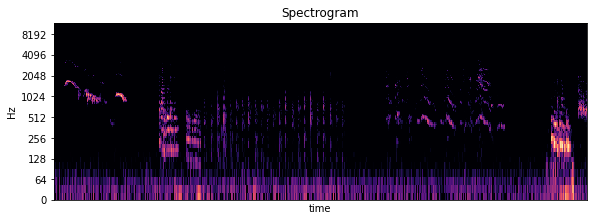

In [ ]:
stft = np.abs(np.squeeze(_spectrogram(a2[:1,:])))
stft = librosa.amplitude_to_db(stft, ref=np.max)

plot.figure(figsize=(20, 15))
gs = gridspec.GridSpec(4, 4)


ax0 = plot.subplot(gs[0, 1:3]), librosa.display.specshow(stft.T,sr=24000, x_axis='s', y_axis='log'), plot.xlim([0, 60]), plot.xticks([]), plot.xlabel('time'), plot.title('Spectrogram')

In [ ]:
a2,f2=_load_audio("/content/sample_data/fold1_room1_mix001_ov1.wav")
print(a2.shape)

In [ ]:
import audiomentations
import torchaudio
import numpy as np
import librosa.display
import os
import soundfile as sf

In [ ]:
pathAudio="/content/colab_direcoty/foa_dev"
files = librosa.util.find_files(pathAudio, ext=['wav'])
files = np.asarray(files)
i=0
for y1 in files:
    i=i+1
    print(i)
    k1=os.path.basename(y1)
    m1,n1= os.path.splitext(k1)
    print(m1)
    wave, sample = torchaudio.load(y1)

    if i%5==0:
    # Define effects
      effects = [
                 ["lowpass", "-2", "2500"],  # apply single-pole lowpass filter
                 #["speed", "0.8"],  # reduce the speed
                 #["rate", f"{sample_rate1}"],
                 #["reverb", "-w"],  # Reverbration gives some dramatic feeling
      ]
      wave1, sample1 = torchaudio.sox_effects.apply_effects_tensor(wave, sample, effects)
      print(wave1.shape)
      print("hi")
      path="/content/sample_data/foa_dev1/"+f"{m1}.wav"
      torchaudio.save(path, wave1, sample_rate=24000)
    else:
      print(wave.shape)
      print("bye")
      path="/content/sample_data/foa_dev1/"+f"{m1}.wav"
      torchaudio.save(path, wave, sample_rate=24000)

In [ ]:
!zip -r /content/sample_data/foa_dev1.zip /content/sample_data/foa_dev1

In [ ]:
!cp -r "/content/sample_data/foa_dev1.zip" "/content/colab_direcoty/seld-dcase2020-master/c"


In [ ]:
%cd /content/colab_direcoty/seld-dcase2020-master #low pass with 2500hz
!python batch_feature_extraction.py

In [ ]:
!python seld.py 4

Using TensorFlow backend.
/usr/local/lib/python3.7/dist-packages/tensorflow/python/framework/dtypes.py:516: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint8 = np.dtype([("qint8", np.int8, 1)])
/usr/local/lib/python3.7/dist-packages/tensorflow/python/framework/dtypes.py:517: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_quint8 = np.dtype([("quint8", np.uint8, 1)])
/usr/local/lib/python3.7/dist-packages/tensorflow/python/framework/dtypes.py:518: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint16 = np.dtype([("qint16", np.int16, 1)])
/usr/local/lib/python3.7/dist-packages/tensorflow/python/framework/dtypes.py:519: FutureWarn

In [ ]:
%cd /content/colab_direcoty/seld-dcase2020-master

/content/colab_direcoty/seld-dcase2020-master


In [ ]:
!python calculate_dev_results_from_dcase_output.py

SET: 1
USING DEFAULT PARAMETERS

	quick_test: False
	dataset_dir: /content/colab_direcoty
	feat_label_dir: /content/colab_direcoty/feat_label/
	model_dir: models/
	dcase_output: True
	dcase_dir: results/
	mode: dev
	dataset: foa
	fs: 24000
	hop_len_s: 0.02
	label_hop_len_s: 0.1
	max_audio_len_s: 60
	nb_mel_bins: 64
	label_sequence_length: 60
	batch_size: 128
	dropout_rate: 0
	nb_cnn2d_filt: 64
	f_pool_size: [4, 4, 2]
	rnn_size: [128, 128]
	fnn_size: [128]
	loss_weights: [1.0, 1000.0]
	nb_epochs: 50
	epochs_per_fit: 5
	doa_objective: masked_mse
	lad_doa_thresh: 20
	feature_sequence_length: 300
	t_pool_size: [5, 1, 1]
	patience: 50
	unique_classes: {'alarm': 0, 'baby': 1, 'crash': 2, 'dog': 3, 'engine': 4, 'female_scream': 5, 'female_speech': 6, 'fire': 7, 'footsteps': 8, 'knock': 9, 'male_scream': 10, 'male_speech': 11, 'phone': 12, 'piano': 13}
Number of predicted files: 100
Number of reference files: 601

Calculating ['all', 'ov', 'ir'] scores for 4_foa_dev


-------------------------

In [ ]:
!python visualize_SELD_output.py

SET: 1
USING DEFAULT PARAMETERS

	quick_test: False
	dataset_dir: /content/colab_direcoty
	feat_label_dir: /content/colab_direcoty/feat_label/
	model_dir: models/
	dcase_output: True
	dcase_dir: results/
	mode: dev
	dataset: foa
	fs: 24000
	hop_len_s: 0.02
	label_hop_len_s: 0.1
	max_audio_len_s: 60
	nb_mel_bins: 64
	label_sequence_length: 60
	batch_size: 128
	dropout_rate: 0
	nb_cnn2d_filt: 64
	f_pool_size: [4, 4, 2]
	rnn_size: [128, 128]
	fnn_size: [128]
	loss_weights: [1.0, 1000.0]
	nb_epochs: 50
	epochs_per_fit: 5
	doa_objective: masked_mse
	lad_doa_thresh: 20
	feature_sequence_length: 300
	t_pool_size: [5, 1, 1]
	patience: 50
	unique_classes: {'alarm': 0, 'baby': 1, 'crash': 2, 'dog': 3, 'engine': 4, 'female_scream': 5, 'female_speech': 6, 'fire': 7, 'footsteps': 8, 'knock': 9, 'male_scream': 10, 'male_speech': 11, 'phone': 12, 'piano': 13}
hi
hi


In [ ]:
# guassian noise 30% data set


**<h3> guassian noise 30% data set</h3>**


In [ ]:
!python batch_feature_extraction.py

In [ ]:
!python seld.py 4

Using TensorFlow backend.
/usr/local/lib/python3.7/dist-packages/tensorflow/python/framework/dtypes.py:516: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint8 = np.dtype([("qint8", np.int8, 1)])
/usr/local/lib/python3.7/dist-packages/tensorflow/python/framework/dtypes.py:517: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_quint8 = np.dtype([("quint8", np.uint8, 1)])
/usr/local/lib/python3.7/dist-packages/tensorflow/python/framework/dtypes.py:518: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint16 = np.dtype([("qint16", np.int16, 1)])
/usr/local/lib/python3.7/dist-packages/tensorflow/python/framework/dtypes.py:519: FutureWarn

In [ ]:
!python seld.py

Using TensorFlow backend.
/usr/local/lib/python3.7/dist-packages/tensorflow/python/framework/dtypes.py:516: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint8 = np.dtype([("qint8", np.int8, 1)])
/usr/local/lib/python3.7/dist-packages/tensorflow/python/framework/dtypes.py:517: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_quint8 = np.dtype([("quint8", np.uint8, 1)])
/usr/local/lib/python3.7/dist-packages/tensorflow/python/framework/dtypes.py:518: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint16 = np.dtype([("qint16", np.int16, 1)])
/usr/local/lib/python3.7/dist-packages/tensorflow/python/framework/dtypes.py:519: FutureWarn

In [ ]:
!python calculate_dev_results_from_dcase_output.py

SET: 1
USING DEFAULT PARAMETERS

	quick_test: False
	dataset_dir: /content/colab_direcoty
	feat_label_dir: /content/colab_direcoty/feat_label/
	model_dir: models/
	dcase_output: True
	dcase_dir: results/
	mode: dev
	dataset: foa
	fs: 24000
	hop_len_s: 0.02
	label_hop_len_s: 0.1
	max_audio_len_s: 60
	nb_mel_bins: 64
	label_sequence_length: 60
	batch_size: 128
	dropout_rate: 0
	nb_cnn2d_filt: 64
	f_pool_size: [4, 4, 2]
	rnn_size: [128, 128]
	fnn_size: [128]
	loss_weights: [1.0, 1000.0]
	nb_epochs: 50
	epochs_per_fit: 5
	doa_objective: masked_mse
	lad_doa_thresh: 20
	feature_sequence_length: 300
	t_pool_size: [5, 1, 1]
	patience: 50
	unique_classes: {'alarm': 0, 'baby': 1, 'crash': 2, 'dog': 3, 'engine': 4, 'female_scream': 5, 'female_speech': 6, 'fire': 7, 'footsteps': 8, 'knock': 9, 'male_scream': 10, 'male_speech': 11, 'phone': 12, 'piano': 13}
Number of predicted files: 100
Number of reference files: 601

Calculating ['all', 'ov', 'ir'] scores for 4_foa_dev


-------------------------

In [ ]:
!python calculate_dev_results_from_dcase_output.py

SET: 1
USING DEFAULT PARAMETERS

	quick_test: False
	dataset_dir: /content/colab_direcoty
	feat_label_dir: /content/colab_direcoty/feat_label/
	model_dir: models/
	dcase_output: True
	dcase_dir: results/
	mode: eval
	dataset: foa
	fs: 24000
	hop_len_s: 0.02
	label_hop_len_s: 0.1
	max_audio_len_s: 60
	nb_mel_bins: 64
	label_sequence_length: 60
	batch_size: 128
	dropout_rate: 0
	nb_cnn2d_filt: 64
	f_pool_size: [4, 4, 2]
	rnn_size: [128, 128]
	fnn_size: [128]
	loss_weights: [1.0, 1000.0]
	nb_epochs: 50
	epochs_per_fit: 5
	doa_objective: masked_mse
	lad_doa_thresh: 20
	feature_sequence_length: 300
	t_pool_size: [5, 1, 1]
	patience: 50
	unique_classes: {'alarm': 0, 'baby': 1, 'crash': 2, 'dog': 3, 'engine': 4, 'female_scream': 5, 'female_speech': 6, 'fire': 7, 'footsteps': 8, 'knock': 9, 'male_scream': 10, 'male_speech': 11, 'phone': 12, 'piano': 13}
Number of predicted files: 200
Number of reference files: 200

Calculating ['all', 'ov', 'ir'] scores for 1_foa_eval


-----------------------

In [ ]:
!python visualize_SELD_output.py

SET: 1
USING DEFAULT PARAMETERS

	quick_test: False
	dataset_dir: /content/colab_direcoty
	feat_label_dir: /content/colab_direcoty/feat_label/
	model_dir: models/
	dcase_output: True
	dcase_dir: results/
	mode: dev
	dataset: foa
	fs: 24000
	hop_len_s: 0.02
	label_hop_len_s: 0.1
	max_audio_len_s: 60
	nb_mel_bins: 64
	label_sequence_length: 60
	batch_size: 128
	dropout_rate: 0
	nb_cnn2d_filt: 64
	f_pool_size: [4, 4, 2]
	rnn_size: [128, 128]
	fnn_size: [128]
	loss_weights: [1.0, 1000.0]
	nb_epochs: 50
	epochs_per_fit: 5
	doa_objective: masked_mse
	lad_doa_thresh: 20
	feature_sequence_length: 300
	t_pool_size: [5, 1, 1]
	patience: 50
	unique_classes: {'alarm': 0, 'baby': 1, 'crash': 2, 'dog': 3, 'engine': 4, 'female_scream': 5, 'female_speech': 6, 'fire': 7, 'footsteps': 8, 'knock': 9, 'male_scream': 10, 'male_speech': 11, 'phone': 12, 'piano': 13}
hi
/usr/local/lib/python3.7/dist-packages/audiomentations/core/transforms_interface.py:58: UserWarning: Warning: input samples have np.float64 

In [ ]:
!python visualize_SELD_output.py

SET: 1
USING DEFAULT PARAMETERS

	quick_test: False
	dataset_dir: /content/colab_direcoty
	feat_label_dir: /content/colab_direcoty/feat_label/
	model_dir: models/
	dcase_output: True
	dcase_dir: results/
	mode: dev
	dataset: foa
	fs: 24000
	hop_len_s: 0.02
	label_hop_len_s: 0.1
	max_audio_len_s: 60
	nb_mel_bins: 64
	label_sequence_length: 60
	batch_size: 128
	dropout_rate: 0
	nb_cnn2d_filt: 64
	f_pool_size: [4, 4, 2]
	rnn_size: [128, 128]
	fnn_size: [128]
	loss_weights: [1.0, 1000.0]
	nb_epochs: 50
	epochs_per_fit: 5
	doa_objective: masked_mse
	lad_doa_thresh: 20
	feature_sequence_length: 300
	t_pool_size: [5, 1, 1]
	patience: 50
	unique_classes: {'alarm': 0, 'baby': 1, 'crash': 2, 'dog': 3, 'engine': 4, 'female_scream': 5, 'female_speech': 6, 'fire': 7, 'footsteps': 8, 'knock': 9, 'male_scream': 10, 'male_speech': 11, 'phone': 12, 'piano': 13}
hi
/usr/local/lib/python3.7/dist-packages/audiomentations/core/transforms_interface.py:58: UserWarning: Warning: input samples have np.float64 

In [ ]:
#time stretch

#time stretch

In [ ]:
def _load_audio(audio_path):
        augment = Compose([#AddGaussianNoise(min_amplitude=0.001, max_amplitude=0.015, p=0.3),
                          #TimeStretch(min_rate=0.8, max_rate=1.25,p=0.3),
                          PitchShift(min_semitones=-1, max_semitones=1,p=1),
                          #Shift(min_fraction=-0.5, max_fraction=0.5, p=0.3),
                          ])

        fs, audio = wav.read(audio_path)
        _nb_channels = 4
        _eps = 1e-8
        _audio_max_len_samples=1440000 #60*24000
        audio = audio[:_nb_channels,:] / 32768.0 + _eps
        if audio.shape[1] < _audio_max_len_samples:
            zero_pad = np.random.rand(_audio_max_len_samples - audio.shape[1], audio.shape[0])*_eps
            audio = np.vstack((audio, zero_pad))
        elif audio.shape[1] > _audio_max_len_samples:
            audio = audio[:_audio_max_len_samples, :]
        audio=np.reshape(audio, (4, 1440000))
        print(audio.shape)
        audio = augment(audio,24000)
        audio=np.reshape(audio, (1440000,4))
        print("hi")
        return audio, fs

In [ ]:
i1,i2=_load_audio("/content/sample_data/fold1_room1_mix001_ov1.wav")
print(i1.shape)

(4, 1440000)


/usr/local/lib/python3.7/dist-packages/audiomentations/core/transforms_interface.py:58: UserWarning: Warning: input samples have np.float64 dtype. Converting to np.float32...
  "Warning: input samples have np.float64 dtype. Converting to np.float32..."
/usr/local/lib/python3.7/dist-packages/audiomentations/augmentations/transforms.py:414: FutureWarning: Pass sr=24000 as keyword args. From version 0.10 passing these as positional arguments will result in an error
  n_steps=self.parameters["num_semitones"],


hi
(1440000, 4)


In [ ]:
!python batch_feature_extraction.py

In [ ]:
!python seld.py 4

Using TensorFlow backend.
/usr/local/lib/python3.7/dist-packages/tensorflow/python/framework/dtypes.py:516: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint8 = np.dtype([("qint8", np.int8, 1)])
/usr/local/lib/python3.7/dist-packages/tensorflow/python/framework/dtypes.py:517: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_quint8 = np.dtype([("quint8", np.uint8, 1)])
/usr/local/lib/python3.7/dist-packages/tensorflow/python/framework/dtypes.py:518: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint16 = np.dtype([("qint16", np.int16, 1)])
/usr/local/lib/python3.7/dist-packages/tensorflow/python/framework/dtypes.py:519: FutureWarn

In [ ]:
%cd /content/colab_direcoty/seld-dcase2020-master
!python seld.py

/content/colab_direcoty/seld-dcase2020-master
Using TensorFlow backend.
/usr/local/lib/python3.7/dist-packages/tensorflow/python/framework/dtypes.py:516: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint8 = np.dtype([("qint8", np.int8, 1)])
/usr/local/lib/python3.7/dist-packages/tensorflow/python/framework/dtypes.py:517: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_quint8 = np.dtype([("quint8", np.uint8, 1)])
/usr/local/lib/python3.7/dist-packages/tensorflow/python/framework/dtypes.py:518: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint16 = np.dtype([("qint16", np.int16, 1)])
/usr/local/lib/python3.7/dist-packages/tensorf

In [ ]:
!python calculate_dev_results_from_dcase_output.py

SET: 1
USING DEFAULT PARAMETERS

	quick_test: False
	dataset_dir: /content/colab_direcoty
	feat_label_dir: /content/colab_direcoty/feat_label/
	model_dir: models/
	dcase_output: True
	dcase_dir: results/
	mode: dev
	dataset: foa
	fs: 24000
	hop_len_s: 0.02
	label_hop_len_s: 0.1
	max_audio_len_s: 60
	nb_mel_bins: 64
	label_sequence_length: 60
	batch_size: 128
	dropout_rate: 0
	nb_cnn2d_filt: 64
	f_pool_size: [4, 4, 2]
	rnn_size: [128, 128]
	fnn_size: [128]
	loss_weights: [1.0, 1000.0]
	nb_epochs: 50
	epochs_per_fit: 5
	doa_objective: masked_mse
	lad_doa_thresh: 20
	feature_sequence_length: 300
	t_pool_size: [5, 1, 1]
	patience: 50
	unique_classes: {'alarm': 0, 'baby': 1, 'crash': 2, 'dog': 3, 'engine': 4, 'female_scream': 5, 'female_speech': 6, 'fire': 7, 'footsteps': 8, 'knock': 9, 'male_scream': 10, 'male_speech': 11, 'phone': 12, 'piano': 13}
Number of predicted files: 100
Number of reference files: 601

Calculating ['all', 'ov', 'ir'] scores for 4_foa_dev


-------------------------

In [ ]:
!python calculate_dev_results_from_dcase_output.py

SET: 1
USING DEFAULT PARAMETERS

	quick_test: False
	dataset_dir: /content/colab_direcoty
	feat_label_dir: /content/colab_direcoty/feat_label/
	model_dir: models/
	dcase_output: True
	dcase_dir: results/
	mode: dev
	dataset: foa
	fs: 24000
	hop_len_s: 0.02
	label_hop_len_s: 0.1
	max_audio_len_s: 60
	nb_mel_bins: 64
	label_sequence_length: 60
	batch_size: 128
	dropout_rate: 0
	nb_cnn2d_filt: 64
	f_pool_size: [4, 4, 2]
	rnn_size: [128, 128]
	fnn_size: [128]
	loss_weights: [1.0, 1000.0]
	nb_epochs: 50
	epochs_per_fit: 5
	doa_objective: masked_mse
	lad_doa_thresh: 20
	feature_sequence_length: 300
	t_pool_size: [5, 1, 1]
	patience: 50
	unique_classes: {'alarm': 0, 'baby': 1, 'crash': 2, 'dog': 3, 'engine': 4, 'female_scream': 5, 'female_speech': 6, 'fire': 7, 'footsteps': 8, 'knock': 9, 'male_scream': 10, 'male_speech': 11, 'phone': 12, 'piano': 13}
Number of predicted files: 200
Number of reference files: 200

Calculating ['all', 'ov', 'ir'] scores for 1_foa_eval


------------------------

In [ ]:
!python visualize_SELD_output.py

SET: 1
USING DEFAULT PARAMETERS

	quick_test: False
	dataset_dir: /content/colab_direcoty
	feat_label_dir: /content/colab_direcoty/feat_label/
	model_dir: models/
	dcase_output: True
	dcase_dir: results/
	mode: dev
	dataset: foa
	fs: 24000
	hop_len_s: 0.02
	label_hop_len_s: 0.1
	max_audio_len_s: 60
	nb_mel_bins: 64
	label_sequence_length: 60
	batch_size: 128
	dropout_rate: 0
	nb_cnn2d_filt: 64
	f_pool_size: [4, 4, 2]
	rnn_size: [128, 128]
	fnn_size: [128]
	loss_weights: [1.0, 1000.0]
	nb_epochs: 50
	epochs_per_fit: 5
	doa_objective: masked_mse
	lad_doa_thresh: 20
	feature_sequence_length: 300
	t_pool_size: [5, 1, 1]
	patience: 50
	unique_classes: {'alarm': 0, 'baby': 1, 'crash': 2, 'dog': 3, 'engine': 4, 'female_scream': 5, 'female_speech': 6, 'fire': 7, 'footsteps': 8, 'knock': 9, 'male_scream': 10, 'male_speech': 11, 'phone': 12, 'piano': 13}
hi
/usr/local/lib/python3.7/dist-packages/audiomentations/core/transforms_interface.py:58: UserWarning: Warning: input samples have np.float64 

pitch shift

In [ ]:
!python batch_feature_extraction.py

In [ ]:
!python seld.py 4

Using TensorFlow backend.
/usr/local/lib/python3.7/dist-packages/tensorflow/python/framework/dtypes.py:516: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint8 = np.dtype([("qint8", np.int8, 1)])
/usr/local/lib/python3.7/dist-packages/tensorflow/python/framework/dtypes.py:517: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_quint8 = np.dtype([("quint8", np.uint8, 1)])
/usr/local/lib/python3.7/dist-packages/tensorflow/python/framework/dtypes.py:518: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint16 = np.dtype([("qint16", np.int16, 1)])
/usr/local/lib/python3.7/dist-packages/tensorflow/python/framework/dtypes.py:519: FutureWarn

In [ ]:
!python seld.py 5

Using TensorFlow backend.
/usr/local/lib/python3.7/dist-packages/tensorflow/python/framework/dtypes.py:516: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint8 = np.dtype([("qint8", np.int8, 1)])
/usr/local/lib/python3.7/dist-packages/tensorflow/python/framework/dtypes.py:517: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_quint8 = np.dtype([("quint8", np.uint8, 1)])
/usr/local/lib/python3.7/dist-packages/tensorflow/python/framework/dtypes.py:518: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint16 = np.dtype([("qint16", np.int16, 1)])
/usr/local/lib/python3.7/dist-packages/tensorflow/python/framework/dtypes.py:519: FutureWarn

In [ ]:
%cd /content/colab_direcoty/seld-dcase2020-master

/content/colab_direcoty/seld-dcase2020-master


In [ ]:
!python calculate_dev_results_from_dcase_output.py

SET: 1
USING DEFAULT PARAMETERS

	quick_test: False
	dataset_dir: /content/colab_direcoty
	feat_label_dir: /content/colab_direcoty/feat_label/
	model_dir: models/
	dcase_output: True
	dcase_dir: results/
	mode: dev
	dataset: foa
	fs: 24000
	hop_len_s: 0.02
	label_hop_len_s: 0.1
	max_audio_len_s: 60
	nb_mel_bins: 64
	label_sequence_length: 60
	batch_size: 128
	dropout_rate: 0
	nb_cnn2d_filt: 64
	f_pool_size: [4, 4, 2]
	rnn_size: [128, 128]
	fnn_size: [128]
	loss_weights: [1.0, 1000.0]
	nb_epochs: 50
	epochs_per_fit: 5
	doa_objective: masked_mse
	lad_doa_thresh: 20
	feature_sequence_length: 300
	t_pool_size: [5, 1, 1]
	patience: 50
	unique_classes: {'alarm': 0, 'baby': 1, 'crash': 2, 'dog': 3, 'engine': 4, 'female_scream': 5, 'female_speech': 6, 'fire': 7, 'footsteps': 8, 'knock': 9, 'male_scream': 10, 'male_speech': 11, 'phone': 12, 'piano': 13}
Number of predicted files: 100
Number of reference files: 601

Calculating ['all', 'ov', 'ir'] scores for 4_foa_dev


-------------------------

In [ ]:
!python visualize_SELD_output.py

SET: 1
USING DEFAULT PARAMETERS

	quick_test: False
	dataset_dir: /content/colab_direcoty
	feat_label_dir: /content/colab_direcoty/feat_label/
	model_dir: models/
	dcase_output: True
	dcase_dir: results/
	mode: eval
	dataset: foa
	fs: 24000
	hop_len_s: 0.02
	label_hop_len_s: 0.1
	max_audio_len_s: 60
	nb_mel_bins: 64
	label_sequence_length: 60
	batch_size: 128
	dropout_rate: 0
	nb_cnn2d_filt: 64
	f_pool_size: [4, 4, 2]
	rnn_size: [128, 128]
	fnn_size: [128]
	loss_weights: [1.0, 1000.0]
	nb_epochs: 50
	epochs_per_fit: 5
	doa_objective: masked_mse
	lad_doa_thresh: 20
	feature_sequence_length: 300
	t_pool_size: [5, 1, 1]
	patience: 50
	unique_classes: {'alarm': 0, 'baby': 1, 'crash': 2, 'dog': 3, 'engine': 4, 'female_scream': 5, 'female_speech': 6, 'fire': 7, 'footsteps': 8, 'knock': 9, 'male_scream': 10, 'male_speech': 11, 'phone': 12, 'piano': 13}
hi
/usr/local/lib/python3.7/dist-packages/audiomentations/core/transforms_interface.py:58: UserWarning: Warning: input samples have np.float64

**shift**

In [ ]:
!python batch_feature_extraction.py

In [ ]:
!python seld.py

Using TensorFlow backend.
/usr/local/lib/python3.7/dist-packages/tensorflow/python/framework/dtypes.py:516: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint8 = np.dtype([("qint8", np.int8, 1)])
/usr/local/lib/python3.7/dist-packages/tensorflow/python/framework/dtypes.py:517: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_quint8 = np.dtype([("quint8", np.uint8, 1)])
/usr/local/lib/python3.7/dist-packages/tensorflow/python/framework/dtypes.py:518: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint16 = np.dtype([("qint16", np.int16, 1)])
/usr/local/lib/python3.7/dist-packages/tensorflow/python/framework/dtypes.py:519: FutureWarn

In [ ]:
!python seld.py 5

Using TensorFlow backend.
/usr/local/lib/python3.7/dist-packages/tensorflow/python/framework/dtypes.py:516: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint8 = np.dtype([("qint8", np.int8, 1)])
/usr/local/lib/python3.7/dist-packages/tensorflow/python/framework/dtypes.py:517: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_quint8 = np.dtype([("quint8", np.uint8, 1)])
/usr/local/lib/python3.7/dist-packages/tensorflow/python/framework/dtypes.py:518: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint16 = np.dtype([("qint16", np.int16, 1)])
/usr/local/lib/python3.7/dist-packages/tensorflow/python/framework/dtypes.py:519: FutureWarn

In [ ]:
!python calculate_dev_results_from_dcase_output.py

SET: 1
USING DEFAULT PARAMETERS

	quick_test: False
	dataset_dir: /content/colab_direcoty
	feat_label_dir: /content/colab_direcoty/feat_label/
	model_dir: models/
	dcase_output: True
	dcase_dir: results/
	mode: dev
	dataset: foa
	fs: 24000
	hop_len_s: 0.02
	label_hop_len_s: 0.1
	max_audio_len_s: 60
	nb_mel_bins: 64
	label_sequence_length: 60
	batch_size: 128
	dropout_rate: 0
	nb_cnn2d_filt: 64
	f_pool_size: [4, 4, 2]
	rnn_size: [128, 128]
	fnn_size: [128]
	loss_weights: [1.0, 1000.0]
	nb_epochs: 50
	epochs_per_fit: 5
	doa_objective: masked_mse
	lad_doa_thresh: 20
	feature_sequence_length: 300
	t_pool_size: [5, 1, 1]
	patience: 50
	unique_classes: {'alarm': 0, 'baby': 1, 'crash': 2, 'dog': 3, 'engine': 4, 'female_scream': 5, 'female_speech': 6, 'fire': 7, 'footsteps': 8, 'knock': 9, 'male_scream': 10, 'male_speech': 11, 'phone': 12, 'piano': 13}
Number of predicted files: 100
Number of reference files: 601

Calculating ['all', 'ov', 'ir'] scores for 1_foa_dev


-------------------------

In [ ]:
!python calculate_dev_results_from_dcase_output.py

SET: 1
USING DEFAULT PARAMETERS

	quick_test: False
	dataset_dir: /content/colab_direcoty
	feat_label_dir: /content/colab_direcoty/feat_label/
	model_dir: models/
	dcase_output: True
	dcase_dir: results/
	mode: eval
	dataset: foa
	fs: 24000
	hop_len_s: 0.02
	label_hop_len_s: 0.1
	max_audio_len_s: 60
	nb_mel_bins: 64
	label_sequence_length: 60
	batch_size: 128
	dropout_rate: 0
	nb_cnn2d_filt: 64
	f_pool_size: [4, 4, 2]
	rnn_size: [128, 128]
	fnn_size: [128]
	loss_weights: [1.0, 1000.0]
	nb_epochs: 50
	epochs_per_fit: 5
	doa_objective: masked_mse
	lad_doa_thresh: 20
	feature_sequence_length: 300
	t_pool_size: [5, 1, 1]
	patience: 50
	unique_classes: {'alarm': 0, 'baby': 1, 'crash': 2, 'dog': 3, 'engine': 4, 'female_scream': 5, 'female_speech': 6, 'fire': 7, 'footsteps': 8, 'knock': 9, 'male_scream': 10, 'male_speech': 11, 'phone': 12, 'piano': 13}
Number of predicted files: 200
Number of reference files: 200

Calculating ['all', 'ov', 'ir'] scores for 5_foa_eval


-----------------------

In [ ]:
!python visualize_SELD_output.py

SET: 1
USING DEFAULT PARAMETERS

	quick_test: False
	dataset_dir: /content/colab_direcoty
	feat_label_dir: /content/colab_direcoty/feat_label/
	model_dir: models/
	dcase_output: True
	dcase_dir: results/
	mode: eval
	dataset: foa
	fs: 24000
	hop_len_s: 0.02
	label_hop_len_s: 0.1
	max_audio_len_s: 60
	nb_mel_bins: 64
	label_sequence_length: 60
	batch_size: 128
	dropout_rate: 0
	nb_cnn2d_filt: 64
	f_pool_size: [4, 4, 2]
	rnn_size: [128, 128]
	fnn_size: [128]
	loss_weights: [1.0, 1000.0]
	nb_epochs: 50
	epochs_per_fit: 5
	doa_objective: masked_mse
	lad_doa_thresh: 20
	feature_sequence_length: 300
	t_pool_size: [5, 1, 1]
	patience: 50
	unique_classes: {'alarm': 0, 'baby': 1, 'crash': 2, 'dog': 3, 'engine': 4, 'female_scream': 5, 'female_speech': 6, 'fire': 7, 'footsteps': 8, 'knock': 9, 'male_scream': 10, 'male_speech': 11, 'phone': 12, 'piano': 13}
hi
/usr/local/lib/python3.7/dist-packages/audiomentations/core/transforms_interface.py:58: UserWarning: Warning: input samples have np.float64

**frequency and time masking 30%**


In [ ]:
def _load_audio(audio_path):
        fs, audio = wav.read(audio_path)
        #print(audio)
        _nb_channels = 4
        _eps = 1e-8
        _audio_max_len_samples=1440000 #60*24000
        audio = audio[:,:_nb_channels] / 32768.0 + _eps
        if audio.shape[0] < _audio_max_len_samples:
            zero_pad = np.random.rand(_audio_max_len_samples - audio.shape[0], audio.shape[1])*_eps
            audio = np.vstack((audio, zero_pad))
        elif audio.shape[0] > _audio_max_len_samples:
            audio = audio[:_audio_max_len_samples, :]
        print("hi")
        #augment = Compose([AddGaussianNoise(min_amplitude=0.001, max_amplitude=0.015, p=0.4),])
        #audio = augment(samples=audio, sample_rate=24000)
        return audio, fs


In [ ]:
from audiomentations.augmentations.transforms import TimeMask
from audiomentations import SpecFrequencyMask
def _spectrogram(audio_input):
        transform = SpecFrequencyMask(fill_mode="constant",fill_constant=0.0,min_mask_fraction=0.06,max_mask_fraction=0.06,p=0.3)
        aug=TimeMask(max_band_part=0.03,min_band_part=0.03,p=0.3)
        _max_feat_frames=3000
        _win_len=960
        _nfft=1024
        _hop_len=480
        _nb_ch = audio_input.shape[1]
        nb_bins = _nfft // 2
        spectra = np.zeros((_max_feat_frames, nb_bins + 1, _nb_ch), dtype=complex)
        for ch_cnt in range(_nb_ch):
            stft_ch = librosa.core.stft(np.asfortranarray(audio_input[:, ch_cnt]), n_fft=_nfft, hop_length=_hop_len,
                                        win_length=_win_len, window='hann')
            stft_ch=transform(stft_ch)#frequency masking
            stft_ch=aug(stft_ch,24000)
            print("hi")
            spectra[:, :, ch_cnt] = stft_ch[:, :_max_feat_frames].T
        return spectra


hi


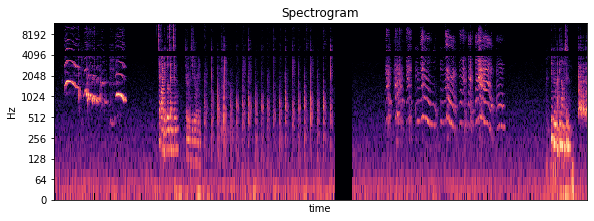

In [ ]:
stft = np.abs(np.squeeze(_spectrogram(a2[:, :1])))
stft = librosa.amplitude_to_db(stft, ref=np.max)

plot.figure(figsize=(20, 15))
gs = gridspec.GridSpec(4, 4)


ax0 = plot.subplot(gs[0, 1:3]), librosa.display.specshow(stft.T,sr=24000, x_axis='s', y_axis='log'), plot.xlim([0, 60]), plot.xticks([]), plot.xlabel('time'), plot.title('Spectrogram')

In [ ]:
a2,f2=_load_audio("/content/sample_data/fold1_room1_mix001_ov1.wav")
print(a2.shape)

hi
(1440000, 4)


In [ ]:
!python batch_feature_extraction.py

In [ ]:
!python batch_feature_extraction.py

In [ ]:
!python seld.py 4

Using TensorFlow backend.
/usr/local/lib/python3.7/dist-packages/tensorflow/python/framework/dtypes.py:516: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint8 = np.dtype([("qint8", np.int8, 1)])
/usr/local/lib/python3.7/dist-packages/tensorflow/python/framework/dtypes.py:517: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_quint8 = np.dtype([("quint8", np.uint8, 1)])
/usr/local/lib/python3.7/dist-packages/tensorflow/python/framework/dtypes.py:518: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint16 = np.dtype([("qint16", np.int16, 1)])
/usr/local/lib/python3.7/dist-packages/tensorflow/python/framework/dtypes.py:519: FutureWarn

In [ ]:
!python batch_feature_extraction.py #20% time+freq

In [ ]:
!python batch_feature_extraction.py

In [ ]:
!python seld.py

Using TensorFlow backend.
/usr/local/lib/python3.7/dist-packages/tensorflow/python/framework/dtypes.py:516: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint8 = np.dtype([("qint8", np.int8, 1)])
/usr/local/lib/python3.7/dist-packages/tensorflow/python/framework/dtypes.py:517: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_quint8 = np.dtype([("quint8", np.uint8, 1)])
/usr/local/lib/python3.7/dist-packages/tensorflow/python/framework/dtypes.py:518: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint16 = np.dtype([("qint16", np.int16, 1)])
/usr/local/lib/python3.7/dist-packages/tensorflow/python/framework/dtypes.py:519: FutureWarn

In [ ]:
#30% 0.06 freq and 0.03 time

In [ ]:
!python batch_feature_extraction.py

In [ ]:
!python seld.py 4

Using TensorFlow backend.
/usr/local/lib/python3.7/dist-packages/tensorflow/python/framework/dtypes.py:516: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint8 = np.dtype([("qint8", np.int8, 1)])
/usr/local/lib/python3.7/dist-packages/tensorflow/python/framework/dtypes.py:517: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_quint8 = np.dtype([("quint8", np.uint8, 1)])
/usr/local/lib/python3.7/dist-packages/tensorflow/python/framework/dtypes.py:518: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint16 = np.dtype([("qint16", np.int16, 1)])
/usr/local/lib/python3.7/dist-packages/tensorflow/python/framework/dtypes.py:519: FutureWarn

In [ ]:
#t:20% and f:40%

In [ ]:
!python batch_feature_extraction.py

In [ ]:
!python seld.py 4

Using TensorFlow backend.
/usr/local/lib/python3.7/dist-packages/tensorflow/python/framework/dtypes.py:516: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint8 = np.dtype([("qint8", np.int8, 1)])
/usr/local/lib/python3.7/dist-packages/tensorflow/python/framework/dtypes.py:517: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_quint8 = np.dtype([("quint8", np.uint8, 1)])
/usr/local/lib/python3.7/dist-packages/tensorflow/python/framework/dtypes.py:518: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint16 = np.dtype([("qint16", np.int16, 1)])
/usr/local/lib/python3.7/dist-packages/tensorflow/python/framework/dtypes.py:519: FutureWarn

In [ ]:
!python seld.py 5

Using TensorFlow backend.
/usr/local/lib/python3.7/dist-packages/tensorflow/python/framework/dtypes.py:516: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint8 = np.dtype([("qint8", np.int8, 1)])
/usr/local/lib/python3.7/dist-packages/tensorflow/python/framework/dtypes.py:517: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_quint8 = np.dtype([("quint8", np.uint8, 1)])
/usr/local/lib/python3.7/dist-packages/tensorflow/python/framework/dtypes.py:518: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint16 = np.dtype([("qint16", np.int16, 1)])
/usr/local/lib/python3.7/dist-packages/tensorflow/python/framework/dtypes.py:519: FutureWarn

In [ ]:
!python calculate_dev_results_from_dcase_output.py

SET: 1
USING DEFAULT PARAMETERS

	quick_test: False
	dataset_dir: /content/colab_direcoty
	feat_label_dir: /content/colab_direcoty/feat_label/
	model_dir: models/
	dcase_output: True
	dcase_dir: results/
	mode: dev
	dataset: foa
	fs: 24000
	hop_len_s: 0.02
	label_hop_len_s: 0.1
	max_audio_len_s: 60
	nb_mel_bins: 64
	label_sequence_length: 60
	batch_size: 128
	dropout_rate: 0
	nb_cnn2d_filt: 64
	f_pool_size: [4, 4, 2]
	rnn_size: [128, 128]
	fnn_size: [128]
	loss_weights: [1.0, 1000.0]
	nb_epochs: 50
	epochs_per_fit: 5
	doa_objective: masked_mse
	lad_doa_thresh: 20
	feature_sequence_length: 300
	t_pool_size: [5, 1, 1]
	patience: 50
	unique_classes: {'alarm': 0, 'baby': 1, 'crash': 2, 'dog': 3, 'engine': 4, 'female_scream': 5, 'female_speech': 6, 'fire': 7, 'footsteps': 8, 'knock': 9, 'male_scream': 10, 'male_speech': 11, 'phone': 12, 'piano': 13}
Number of predicted files: 100
Number of reference files: 601

Calculating ['all', 'ov', 'ir'] scores for 4_foa_dev


-------------------------

In [ ]:
!python calculate_dev_results_from_dcase_output.py

SET: 1
USING DEFAULT PARAMETERS

	quick_test: False
	dataset_dir: /content/colab_direcoty
	feat_label_dir: /content/colab_direcoty/feat_label/
	model_dir: models/
	dcase_output: True
	dcase_dir: results/
	mode: dev
	dataset: foa
	fs: 24000
	hop_len_s: 0.02
	label_hop_len_s: 0.1
	max_audio_len_s: 60
	nb_mel_bins: 64
	label_sequence_length: 60
	batch_size: 128
	dropout_rate: 0
	nb_cnn2d_filt: 64
	f_pool_size: [4, 4, 2]
	rnn_size: [128, 128]
	fnn_size: [128]
	loss_weights: [1.0, 1000.0]
	nb_epochs: 50
	epochs_per_fit: 5
	doa_objective: masked_mse
	lad_doa_thresh: 20
	feature_sequence_length: 300
	t_pool_size: [5, 1, 1]
	patience: 50
	unique_classes: {'alarm': 0, 'baby': 1, 'crash': 2, 'dog': 3, 'engine': 4, 'female_scream': 5, 'female_speech': 6, 'fire': 7, 'footsteps': 8, 'knock': 9, 'male_scream': 10, 'male_speech': 11, 'phone': 12, 'piano': 13}
Number of predicted files: 200
Number of reference files: 200

Calculating ['all', 'ov', 'ir'] scores for 5_foa_eval


------------------------

In [ ]:
!python visualize_SELD_output.py

SET: 1
USING DEFAULT PARAMETERS

	quick_test: False
	dataset_dir: /content/colab_direcoty
	feat_label_dir: /content/colab_direcoty/feat_label/
	model_dir: models/
	dcase_output: True
	dcase_dir: results/
	mode: dev
	dataset: foa
	fs: 24000
	hop_len_s: 0.02
	label_hop_len_s: 0.1
	max_audio_len_s: 60
	nb_mel_bins: 64
	label_sequence_length: 60
	batch_size: 128
	dropout_rate: 0
	nb_cnn2d_filt: 64
	f_pool_size: [4, 4, 2]
	rnn_size: [128, 128]
	fnn_size: [128]
	loss_weights: [1.0, 1000.0]
	nb_epochs: 50
	epochs_per_fit: 5
	doa_objective: masked_mse
	lad_doa_thresh: 20
	feature_sequence_length: 300
	t_pool_size: [5, 1, 1]
	patience: 50
	unique_classes: {'alarm': 0, 'baby': 1, 'crash': 2, 'dog': 3, 'engine': 4, 'female_scream': 5, 'female_speech': 6, 'fire': 7, 'footsteps': 8, 'knock': 9, 'male_scream': 10, 'male_speech': 11, 'phone': 12, 'piano': 13}
hi
hi
